C:\Users\diego\AppData\Local\Temp\ipykernel_19364\4149640294.py:51: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  mass1.set_data(-0.5, y1[frame])
C:\Users\diego\AppData\Local\Temp\ipykernel_19364\4149640294.py:52: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  mass2.set_data(0, y2[frame])
C:\Users\diego\AppData\Local\Temp\ipykernel_19364\4149640294.py:53: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  mass3.set_data(0.5, y3[frame])
C:\Users\diego\AppData\Local\Temp\ipykernel_19364\4149640294.py:51: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  mass1.set_data(-0.5, y1[frame])
C:\Users\diego\AppData\Local\Temp\ipykernel_19364\41

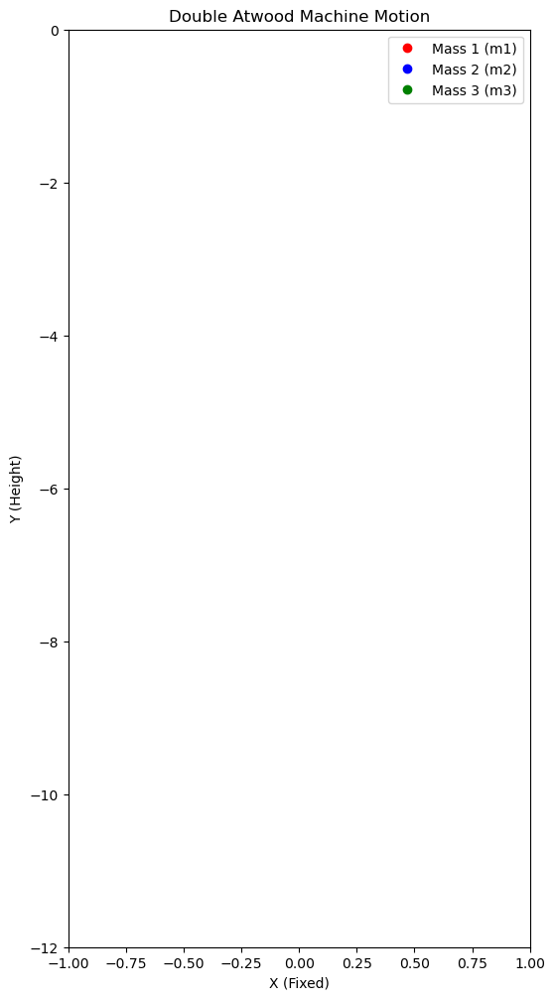

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Parameters
g = 9.81
L = 5.0
L_prime = 5.0
m1, m2, m3 = 2, 3, 4
y1_0, y2_0, y3_0 = -L, -(L + L_prime), -(L + L_prime)

def a1(m1, m2, m3):
    return -g * (m1 * (m2 + m3) - 4 * m2 * m3) / (m1 * (m2 + m3) + 4 * m2 * m3)
def a2(m1, m2, m3):
    return -g * (m2 * (m1 + m3) - 4 * m1 * m3) / (m1 * (m2 + m3) + 4 * m2 * m3)
def a3(m1, m2, m3):
    return -g * (m3 * (m1 - m2) + 4 * m1 * m2) / (m1 * (m2 + m3) + 4 * m2 * m3)

a1_val, a2_val, a3_val = a1(m1, m2, m3), a2(m1, m2, m3), a3(m1, m2, m3)

# Time settings
dt, t_max = 0.01, 10
t = np.arange(0, t_max, dt)

y1, y2, y3 = [y1_0], [y2_0], [y3_0]
v1, v2, v3 = 0, 0, 0

for _ in t[1:]:
    v1 += a1_val * dt
    v2 += a2_val * dt
    v3 += a3_val * dt
    y1.append(y1[-1] + v1 * dt)
    y2.append(y2[-1] + v2 * dt)
    y3.append(y3[-1] + v3 * dt)

# Create animation
fig, ax = plt.subplots(figsize=(6, 12))  # Larger vertical figure
ax.set_xlim(-1, 1)
ax.set_ylim(-L - L_prime - 2, 0)
ax.set_title("Double Atwood Machine Motion")
ax.set_xlabel("X (Fixed)")
ax.set_ylabel("Y (Height)")

mass1, = ax.plot([], [], 'o', color='red', label='Mass 1 (m1)')
mass2, = ax.plot([], [], 'o', color='blue', label='Mass 2 (m2)')
mass3, = ax.plot([], [], 'o', color='green', label='Mass 3 (m3)')
ax.legend()

def update(frame):
    mass1.set_data(-0.5, y1[frame])
    mass2.set_data(0, y2[frame])
    mass3.set_data(0.5, y3[frame])
    return mass1, mass2, mass3

ani = FuncAnimation(fig, update, frames=len(t), interval=dt*1000, blit=True)
HTML(ani.to_jshtml())


In [ ]:
Double Atwood Machine Simulation

Purpose
This project simulates the motion of a **Double Atwood Machine**, a system involving three masses connected by ropes and pulleys. The simulation animates the resultant motion of the masses based on given accelerations derived from the equations of motion.

Features
- Computes accelerations of each mass based on their respective equations of motion.
- Simulates the positions of the masses over time using numerical integration.
- Animates the motion of the masses with horizontal offsets for clarity.
- Adjustable parameters for mass values, rope lengths, and gravitational acceleration.

Dependencies
The project requires the following Python libraries:
- `numpy` for numerical computations.
- `matplotlib` for creating the animation and visualizing the motion.
- `IPython` for embedding the animation inline in Jupyter Notebooks.